# **Data and Sampling Distributions**

In [9]:
# Standard Library
from pathlib import Path #Part of Python’s built-in standard library. Provides an object-oriented interface to handle file system paths.

# Third-Party Libraries
import numpy as np
import pandas as pd
from scipy import stats #Part of the SciPy library, focused on statistics and probability. Useful for computing things like distributions, p-values, hypothesis tests.
from sklearn.utils import resample  #From scikit-learn, a machine learning library. resample() is used for bootstrapping or sampling datasets with/without replacement.
import seaborn as sns   #High-level interface for statistical data visualization. Built on top of Matplotlib, and integrates well with pandas DataFrames.
import matplotlib.pyplot as plt

In [10]:
data_dir = Path("Data2")
LOANS_INCOME_CSV = data_dir / 'loans_income.csv'
SP500_DATA_CSV = data_dir / 'sp500_data.csv.gz'

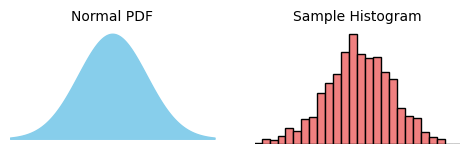

In [11]:
#Figure 2-1

#Set the random seed: Ensures that every time we run the code, the random sample is the same and helps with reproducibility.
np.random.seed(seed=1)

#Generate 300 evenly spaced points between -3 and 3. Used as the x-values to plot the probability density function (PDF) of a standard normal distribution.
x = np.linspace(-3, 3, 300)
xsample = stats.norm.rvs(size=1000) #It generates 1000 random values from a standard normal distribution. rvs() stands for random variates. This simulates sampling from the distribution. 
# "Random variates" means:  Random values generated from a specific probability distribution.
# stats.norm refers to the standard normal distribution (mean = 0, std = 1).
# .rvs(size=1000) stands for "random variates sample", meaning:   Draw 1000 random values that follow the shape of the standard normal distribution.
'''
Actually, we did use:
    np.random.seed(seed=1)
but it wasn't used inside the random sampling function call. Rather, it was used before the call to:
    xsample = stats.norm.rvs(size=1000)
🔍 What np.random.seed(seed=1) does:
It sets the seed for NumPy’s random number generator. This guarantees reproducibility for all random operations (e.g., sampling, shuffling) that rely on NumPy’s RNG.
Why it works here:
Even though we're using scipy.stats.norm.rvs(), SciPy internally uses NumPy’s RNG unless specified otherwise. So by calling np.random.seed(1) before the sampling line, we ensure:
    xsample = stats.norm.rvs(size=1000)
will always generate the same sample every time we run the script.
'''
fig, axes = plt.subplots(ncols=2, figsize=(5, 1.5))
# Create a figure with 2 horizontal subplots
# ncols=2 creates two subplots side by side.
# figsize=(6, 2) defines the size of the entire figure in inches (width × height).


# Left: Normal distribution curve
# axes[0].plot(x, stats.norm.pdf(x), color='blue')
# or
axes[0].fill_between(x, stats.norm.pdf(x), color='skyblue')
# Plot the normal distribution PDF as a filled curve
# stats.norm.pdf(x) computes the PDF values for each x.
# fill_between() shades the area under the curve. 
axes[0].set_xlim(-3, 3) #Set x-axis limits to match data range
axes[0].set_title("Normal PDF", fontsize=10)    #Add a title above the first plot
axes[0].axis('off') #Hide axis ticks and borders for a cleaner visual.

# Right: Histogram of sampled values
axes[1].hist(xsample, bins=30, color='lightcoral', edgecolor='black', density=True)
# Plot a histogram of the sample
# bins=30: Number of histogram bars.
# color='lightcoral': Bar fill color.
# edgecolor='black': Bar border color.
# density=True: Normalizes the histogram so it aligns with the PDF scale.
axes[1].set_xlim(-3, 3) #Match the histogram's x-axis range with the PDF plot
axes[1].set_title("Sample Histogram", fontsize=10)  #Add a title above the histogram
axes[1].axis('off') # Hide axis ticks and borders for the second plot

# Improve spacing
plt.subplots_adjust(left=0.05, right=0.95, wspace=0.2); #Adjust spacing between subplots. Prevents them from overlapping and gives padding around the edges.

### **Sampling Distribution of a Statistic**

In [12]:
loans_income = pd.read_csv(LOANS_INCOME_CSV).squeeze('columns')
# .squeeze('columns'): if the CSV has only one column, it returns a Series instead of a single-column DataFrame.
# When we use .squeeze('columns'), we're saying: “If there's only one column, remove that axis and return a Series instead.”
# .squeeze('columns') ≡ .squeeze(axis=1)


sample_data = pd.DataFrame({
    'income': loans_income.sample(1000),
    'type': 'Data',
})
'''
Randomly selects 1000 values from the dataset.
Creates a DataFrame with two columns:
    'income': the sampled values.
    'type': a label indicating this is raw sample data (not a mean).
we could also say "'type': ['Data'] * 1000" which ['Data'] * 1000 creates a list of 1000 values:
    ['Data', 'Data', 'Data', ..., 'Data']  # 1000 times
This matches the length of the 'income' column, which has 1000 values (since we sampled 1000 items).
but 'type':'Data' also works because Pandas sees this and thinks:
    “Ah, the value 'Data' is a scalar (not a list or array). So I’ll just broadcast this same value down the column.”
So it automatically fills the entire 'type' column with 'Data' repeated for each row.
'''


sample_mean_05 = pd.DataFrame({
    'income': [loans_income.sample(5).mean() for _ in range(1000)],
    'type': 'Mean of 5',
})
'''
For 1000 iterations, it:
    Draws a random sample of 5 incomes.
    Computes their mean.
Stores the 1000 means in the 'income' column.
Adds 'type' as "Mean of 5" for labeling.
'''
sample_mean_20 = pd.DataFrame({
    'income': [loans_income.sample(20).mean() for _ in range(1000)],
    'type': 'Mean of 20',
})

results = pd.concat([sample_data, sample_mean_05, sample_mean_20], ignore_index=True)
'''
pd.concat([...]): joins the three DataFrames vertically (stacked).
ignore_index=True: resets the index so the combined DataFrame has a clean 0–N index.
'''
results.head()


,income,type
0,63000.0,Data
1,92000.0,Data
2,134000.0,Data
3,52000.0,Data
4,43000.0,Data


In [13]:
results['income'].median()

67115.625

In [14]:
results.shape

(3000, 2)

In [15]:
loans_income.head()

0     67000
1     52000
2    100000
3     78762
4     37041
Name: x, dtype: int64

In [16]:
loans_income.info()

<class 'pandas.core.series.Series'>
RangeIndex: 50000 entries, 0 to 49999
Series name: x
Non-Null Count  Dtype
--------------  -----
50000 non-null  int64
dtypes: int64(1)
memory usage: 390.8 KB


In [17]:
loans_income.max()

199000

In [18]:
a = loans_income = pd.read_csv(LOANS_INCOME_CSV)
a.head()

,x
0,67000
1,52000
2,100000
3,78762
4,37041


In [19]:
type(a) #pandas.core.frame.DataFrame
# a.shape #(50000, 1)

pandas.core.frame.DataFrame

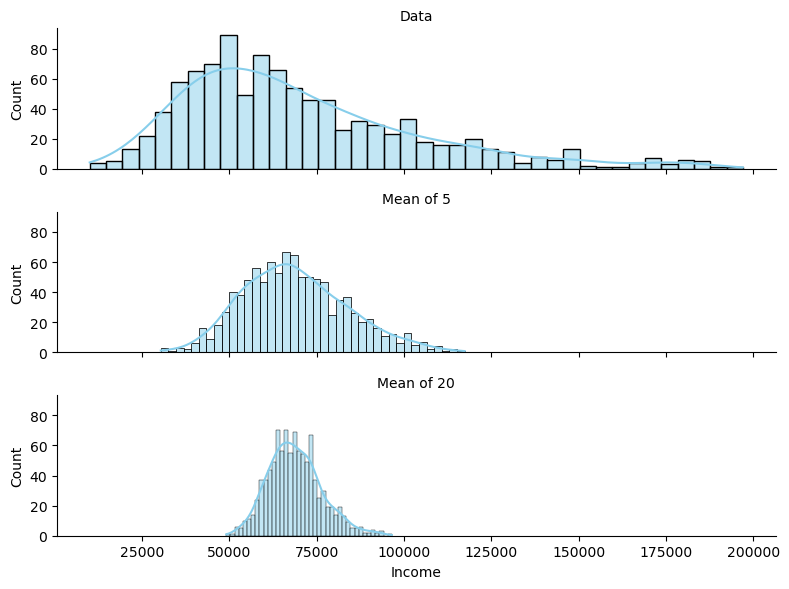

In [20]:
g = sns.FacetGrid(results, col='type', col_wrap=1, height=2, aspect=4)
'''
Creates a separate plot for each value in the type column ('Data', 'Mean of 5', 'Mean of 20').
col_wrap=1 makes the plots stack vertically (1 column layout).
height=2, aspect=4 → Each subplot is 2 inches tall and 8 inches wide.
width = height × aspect = 2 × 4 = 8 inches.
'''
g.map(sns.histplot, 'income', bins=40, color='skyblue', edgecolor='black', kde=True)    #Maps plt.hist() to each subset of data.
# or
# g.map(plt.hist, 'income', range=[0, 200000], bins=40)

g.set_axis_labels('Income', 'Count')
g.set_titles('{col_name}')  #Uses the value of the type column as the title for each subplot.

plt.tight_layout()
plt.show()

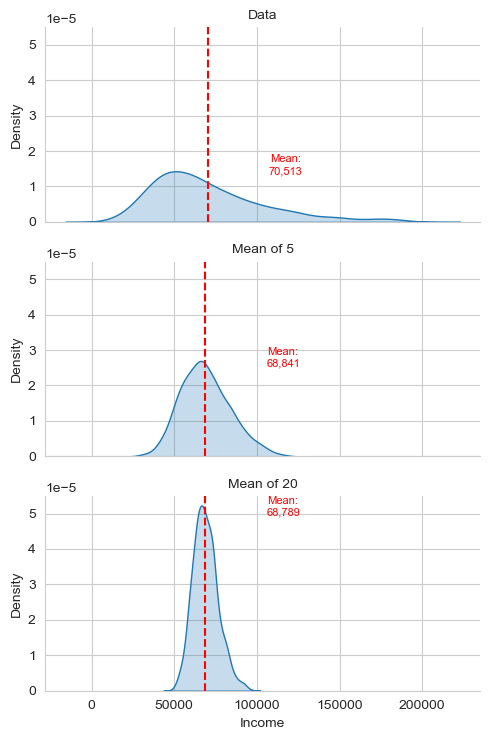

69380.95813333333


In [21]:
# Set Seaborn style
sns.set_style(style='whitegrid')
'''
Sets Seaborn's plot style.
'whitegrid' adds a white background with grid lines, which helps in reading density plots and axes more easily.
'''

# Function to draw KDE and vertical mean line
def plot_kde_with_mean(data, color, **kwargs):
    ax = plt.gca()
    sns.kdeplot(data['income'], fill=True, color=color, ax=ax)
    mean_val = data['income'].mean()
    ax.axvline(mean_val, color='red', linestyle='--', linewidth=1.5)
    ax.text(mean_val+ ax.get_xlim()[1]*0.2, ax.get_ylim()[1]*0.9, f'Mean:\n{mean_val:,.0f}',color='red', ha='center', fontsize=8)
'''
Defines a function that will be applied to each subset of the data in the FacetGrid.
Parameters:
    data: the slice of the DataFrame passed to this subplot (e.g., all rows where type == 'Data')
    color: the color automatically assigned by Seaborn
    **kwargs: catches extra keyword arguments passed by FacetGrid

ax = plt.gca()
    Gets the current Axes object, so we can draw directly on it (used for axvline, text, etc.)

sns.kdeplot(data['income'], fill=True, color=color, ax=ax)
    Plots a kernel density estimate (KDE) of the 'income' values.
    fill=True shades the area under the curve.
    Uses the provided color and draws it on the current ax.

mean_val = data['income'].mean()
    Calculates the mean income of this specific data subset.

ax.axvline(mean_val, color='red', linestyle='--', linewidth=1.5)
    Draws a vertical dashed red line at the mean value to highlight the center of the distribution.

ax.text(mean_val, ax.get_ylim()[1]*0.9, f'Mean:\n{mean_val:,.0f}', color='red', ha='center', fontsize=8)
    Places a text label near the top of the plot, above the mean line.
    ax.get_ylim()[1]*0.9 gets 90% of the y-axis height → positions the label near the top.

The label shows:
Mean:
52,000
(formatted with commas)
'''
# Create FacetGrid
g = sns.FacetGrid(results, col='type', col_wrap=1, height=2.5, aspect=2)
'''
Creates one plot per type category ('Data', 'Mean of 5', 'Mean of 20')
col_wrap=1: stacks them vertically
Each plot is 2.5 inches tall and 2.5 × 2 = 5 inches wide
'''
g.map_dataframe(plot_kde_with_mean)
'''
Applies plot_kde_with_mean() to each panel (i.e., each group in results['type']).
The big difference is:
    g.map() passes column arrays (like NumPy) to simple plotting functions (e.g. plt.hist).
    → Use it for quick, single-variable plots.

    g.map_dataframe() passes the full DataFrame subset to our function.
    → Use it when we need access to multiple columns, compute things like means, or customize plots per group.
'''
# Label and titles
g.set_axis_labels('Income', 'Density')
g.set_titles('{col_name}')
plt.tight_layout()
plt.show()
print(results['income'].mean())


**a really important and nuanced observation here 👇**

✔️ As the sample size increases, the sampling distribution gets narrower (less variance),  
❌ But the mean of the sampling distribution appears to drift slightly farther from the true population mean (≈ 69,381).

Let’s break this down:

**✅ Why the distribution gets narrower:**

This is expected and totally correct:

- Larger sample sizes (like 20) yield more stable sample means.  
- So the sampling distribution of the mean becomes tighter.  
- We can clearly see that in the bottom density plot — it’s much sharper than the middle one.

**😕 Why is the mean not closer to the population mean?**  

This could happen due to random sampling variability — let’s explain:

🔁 we only took one set of 1000 sample means:  
For both "Mean of 5" and "Mean of 20", we drew many small samples from the full population — but each time starting from random draws.  

Even though the spread shrinks, the center (mean) of our resampled means can fluctuate depending on luck in those small samples.

The center will converge to the true mean only **on average** — not necessarily in every single experiment.

**Key idea: Law of Large Numbers works in the long run**  

If we repeated this entire experiment multiple times (like 10 runs of 1000 samples), you’d likely find:

- The sampling distribution from n=20 consistently has lower variance  
- And its mean will be closer to the population mean on average, even if not in this particular run

**✅ What you’re seeing is totally normal:**  

| Sample Size | Spread (Variance) | Mean Closeness          |
|-------------|-------------------|------------------------|
| Small (5)   | Wide              | Roughly close (by luck) |
| Medium (20) | Narrower          | Slightly off (randomly) |

It doesn’t violate the theory — it’s just a reminder that:

**Low variance doesn’t guarantee low bias in a single sample run.**  
for example if we change our seed in np.random.seed(seed=1) and put it eai to 3 instead of 1 yo'll see that also the mean will get closer.


In [22]:
loans_income.head()

,x
0,67000
1,52000
2,100000
3,78762
4,37041


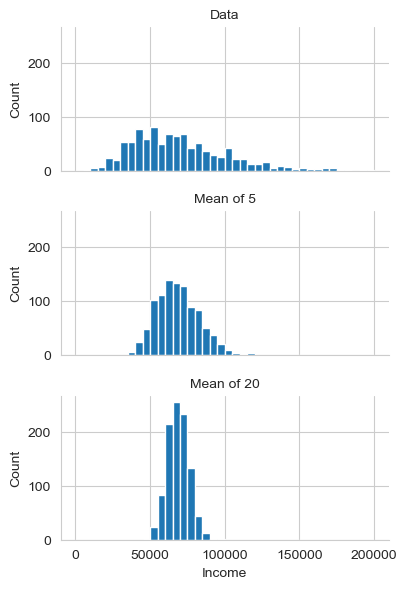

In [23]:
loans_income = pd.read_csv(LOANS_INCOME_CSV).squeeze('columns')
# .squeeze('columns'): if the CSV has only one column, it returns a Series instead of a single-column DataFrame.
# When we use .squeeze('columns'), we're saying: “If there's only one column, remove that axis and return a Series instead.”
# .squeeze('columns') ≡ .squeeze(axis=1)

sample_data = pd.DataFrame({
'income': loans_income.sample(1000),  # This is now 1D
'type': ['Data'] * 1000,
})
sample_mean_05 = pd.DataFrame({
'income': [loans_income.sample(5).mean() for _ in range(1000)],
'type': 'Mean of 5',
})
sample_mean_20 = pd.DataFrame({
'income': [loans_income.sample(20).mean() for _ in range(1000)],
'type': 'Mean of 20',
})
results = pd.concat([sample_data, sample_mean_05, sample_mean_20])
g = sns.FacetGrid(results, col='type', col_wrap=1, height=2, aspect=2)
'''
Splits the data into 3 groups based on 'type' column and plots each group in its own subplot.
col_wrap=1: 1 column layout (i.e., vertical stack of plots)
height=2, aspect=2: Each plot is 2 inches tall and 4 inches wide
'''
g.map(plt.hist, 'income', range=[0, 200000], bins=40)
'''
Plots a histogram of 'income' for each group.
All use the same range and number of bins → ensures comparability across plots.
'''
g.set_axis_labels('Income', 'Count')
g.set_titles('{col_name}');

## **The Bootstrap**

In [24]:
type(loans_income)  #pandas.core.series.Series

pandas.core.series.Series

In [25]:
loans_income_narray = np.array(loans_income)
type(loans_income_narray)

numpy.ndarray

In [26]:
results = []
for nrepeat in range(1000):
    sample = resample(loans_income)
    results.append(sample.median())
results = pd.Series(results)
print('Bootstrap Statistics:')
print(f'original: {loans_income.median()}')
print(f'bias: {results.mean() - loans_income.median()}')
print(f'std. error: {results.std()}')

Bootstrap Statistics:
original: 62000.0
bias: -89.85650000000169
std. error: 233.34343855799503


In [27]:
# import pandas as pd       #pandas for data handling
# import numpy as np        #numpy for numerical operations
# from sklearn.utils import resample    #resample() from sklearn.utils: used for bootstrap sampling (sampling with replacement)

np.random.seed(1)   #Python’s resample() from sklearn.utils uses NumPy's random generator, and unless we set a seed, results differ every run.
# Sets a random seed for reproducibility.
# Ensures the bootstrap samples are the same every time we run the code.

# Reminder: loans_income is a Pandas Series
results = []    #Initializes an empty list to store the bootstrap medians.

#This loop builds the bootstrap distribution of the median:
for _ in range(1000):   #Repeats this 1000 times:
    sample = resample(loans_income)  # Takes a bootstrap sample (random sample with replacement, same size as the original sample (loans_income)). bootstrapped sample with replacement.
    results.append(sample.median()) #Computes the median of the sample and appends the median to the results list.
'''
For each of the 1000 iterations:
step 1: Draw a single value from the original 50,000-sample, record it, then put it back (i.e., sample with replacement).
step 2: Repeat step 1 50,000 times → so we end up with a new sample of size 50,000. That’s our bootstrap sample.
step 3: The result is called a resample, and we compute the statistic (e.g. median) from it.
step 1 and 2 ca be done with just one line of code: 
        sample = resample(loans_income)
Behind the scenes:
The resample() function from sklearn.utils does all 3 steps:
- It generates 50,000 random indices
- Retrieves values from loans_income at those indices
- Returns the full bootstrap sample
'''
results = pd.Series(results) #Converts the list of medians into a Pandas Series so we can use Series methods like .mean() and .std().

print('Bootstrap Statistics:')
print(f'original: {loans_income.median():.2f}') #:.2f means "format as float with 2 decimal places".
print(f'bias: {results.mean() - loans_income.median():.4f}') #Computes the bias: The difference between the average of the bootstrap medians and the original sample median.

print(f'std. error: {results.std(ddof=1):.4f}')
# Python’s Series.std() uses the sample standard deviation by default (ddof=1), because using the population standard deviation (ddof=0) would underestimate the standard error (SE).



Bootstrap Statistics:
original: 62000.00
bias: -69.8845
std. error: 211.6503


In [28]:
# Bootstrap with NumPy + Pandas only:
import pandas as pd
import numpy as np

np.random.seed(1)

# Assume loans_income is a Pandas Series
results = []
n = len(loans_income)

for _ in range(1000):
    # Generate bootstrap sample using np.random.choice
    sample = np.random.choice(loans_income, size=n, replace=True) #This line generates a bootstrap sample using a Numpy function — a new sample of the same size as our original data, drawn with replacement.
    results.append(np.median(sample))

results = pd.Series(results)

print('Bootstrap Statistics:')
print(f'original: {loans_income.median():.2f}')
print(f'bias: {results.mean() - loans_income.median():.4f}')
print(f'std. error: {results.std(ddof=1):.4f}')


Bootstrap Statistics:
original: 62000.00
bias: -69.8845
std. error: 211.6503


In [29]:
type(loans_income)      #pandas.core.series.Series
loans_income.shape

(50000,)

**What does ddof=1 mean?**

**ddof** stands for *Delta Degrees of Freedom*.

It’s a parameter used in calculations of variance and standard deviation to control how the denominator is adjusted:

**Formula difference:**  

| Name                      | Formula                                                                                   | In code     |
|---------------------------|-------------------------------------------------------------------------------------------|-------------|
| Sample standard deviation  | $ s = \sqrt{\frac{1}{n-1} \sum (x_i - \bar{x})^2} $                                    | `ddof=1` ✅ |
| Population standard deviation | $ \sigma = \sqrt{\frac{1}{n} \sum (x_i - \bar{x})^2} $                               | `ddof=0` ❌ |



✅ So:  
- `ddof=1` uses $ n - 1 $ in the denominator → sample standard deviation  
- `ddof=0` uses $ n $ in the denominator → population standard deviation

In most statistical applications (especially bootstrapping, confidence intervals, t-tests), we treat our data as a sample, so we use:

```python
std_error = results.std(ddof=1)
```


**Bootstrap can be used for sample size determination by helping us understand how the variability (uncertainty) of a statistic (its associated standard error) changes as the sample size increases.**

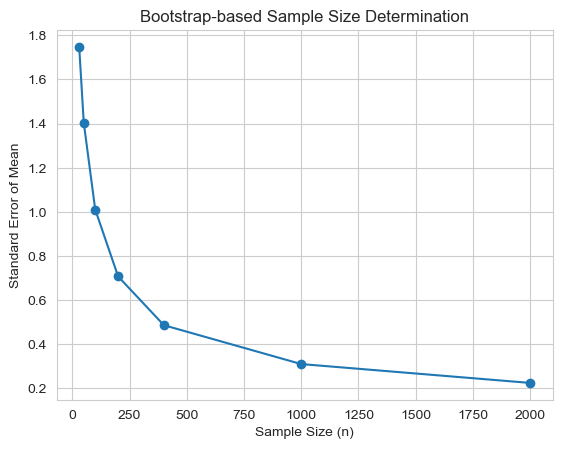

In [30]:
import numpy as np
import matplotlib.pyplot as plt

np.random.seed(42)
data = np.random.normal(50, 10, size=1000)

sample_sizes = [30, 50, 100, 200, 400, 1000, 2000]
bootstrap_se = []

for n in sample_sizes:
    stats = []
    for _ in range(1000):
        sample = np.random.choice(data, size=n, replace=True)
        stats.append(np.mean(sample))
    se = np.std(stats, ddof=1)
    bootstrap_se.append(se)

plt.plot(sample_sizes, bootstrap_se, marker='o')
plt.xlabel("Sample Size (n)")
plt.ylabel("Standard Error of Mean")
plt.title("Bootstrap-based Sample Size Determination")
plt.grid(True)
plt.show()


**This approach lets we see how much the standard error decreases as we increase sample size.
The point where the standard error is below a practical threshold (e.g., SE < 1) can be considered a sufficient sample size.  
In the standard bootstrap procedure, we always resample with replacement using the same size as our original sample.**  

## **Confidence Intervals**  

Now we want a 90% confidence interval for the population mean annual income of loan applicants.  
Two common bootstrap methods:  
- 1) Percentile Method (most intuitive and widely used)
- 2) Normal Approximation Method (using standard error)

Population mean income: 68760.52
Sample of 20 mean income: 55734.10
Mean of the Bootstrap resampling Distribution: 55835.85
std of bootstrap distribution Distribution: 8182.55


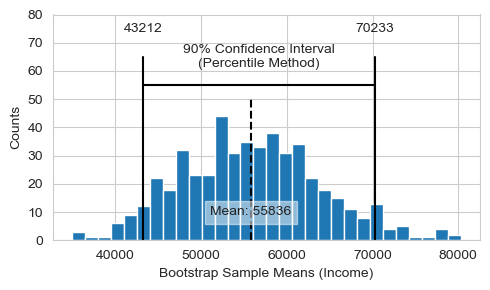

In [31]:
# Percentile Method:
"""
Bootstrap Confidence Interval for the Mean (Sample of 20)

This code simulates the process of estimating the uncertainty (variability) of the mean
annual income of loan applicants using the bootstrap method.

Assumption:
- The variable `loans_income` is treated as the true population.

Steps:
1. Take one random sample of 20 observations from the full dataset (without replacement). It's going to be our original sample.
2. Generate 500 bootstrap resamples from that sample (with replacement).
3. For each resample, compute the sample mean.
4. Construct a 90% confidence interval using the 5th and 95th percentiles of the bootstrap means.
5. Plot a histogram of the bootstrap distribution, mark the confidence interval, and annotate the mean.

This process helps visualize how the sample mean might vary if we could resample repeatedly
and gives an empirical sense of the estimation uncertainty.

Why assume `loans_income` is the population?
------------------------------------------------
In practice, we usually only have access to a limited sample — not the entire population.
To simulate such a real-world scenario, we treat `loans_income` as the full population and
take one small sample (n=20) from it (our original sample). We then apply the bootstrap to that sample to estimate
how much the sample mean might vary. 

If we instead bootstrapped directly on `loans_income`, we’d be estimating the confidence
interval of the dataset's own mean — not simulating the sampling process itself.
"""

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.utils import resample  # or use np.random.choice manually if needed

# Print the population mean
print(f'Population mean income: {loans_income.mean():.2f}')

np.random.seed(3)  

# Step 1: Take one random sample of 20 observations from the population
sample20 = resample(loans_income, n_samples=20, replace=False)
print(f'Sample of 20 mean income: {sample20.mean():.2f}')

# Step 2: Bootstrap resampling
bootstrap_means = []
for _ in range(500):
    boot_sample = resample(sample20)  # sample with replacement
    bootstrap_means.append(boot_sample.mean())

bootstrap_means = pd.Series(bootstrap_means)
print(f'Mean of the Bootstrap resampling Distribution: {bootstrap_means.mean():.2f}')
print(f'std of bootstrap distribution Distribution: {bootstrap_means.std(ddof=1):.2f}')
# Step 3: Compute 90% confidence interval (percentile method)
confidence_interval = list(bootstrap_means.quantile([0.05, 0.95]))  #[43212.45, 70233.43999999999]

# Step 4: Plot the histogram and annotate the results
ax = bootstrap_means.plot.hist(bins=30, figsize=(5, 3)) #This line creates a histogram of the 500 bootstrap means (stored in bootstrap_means), giving wea sense of their distribution.
ax.plot(confidence_interval, [55, 55], color='black') #Draws a horizontal line at height 55 between the lower and upper bounds of the confidence interval to visually mark it.

# Draw vertical lines and annotate interval bounds
for x in confidence_interval:
    ax.plot([x, x], [0, 65], color='black')
    ax.text(x, 75, f'{x:.0f}', ha='center', va='center')
'''
For each bound of the interval (lower and upper), it:
    Draws a vertical line from y=0 to y=65.
    Adds a text label above the line to show the exact value (rounded).
'''

# Label the interval
ax.text(sum(confidence_interval) / 2, 65, '90% Confidence Interval\n(Percentile Method)',ha='center', va='center')

# Draw and annotate the mean of the bootstrap distribution
boot_mean = bootstrap_means.mean()
ax.plot([boot_mean, boot_mean], [0, 50], color='black', linestyle='--')
ax.text(boot_mean, 10, f'Mean: {boot_mean:.0f}',
        bbox=dict(facecolor='white', edgecolor='white', alpha=0.5),
        ha='center', va='center')
'''
bbox=dict(...)
This creates a background box behind the text:
    facecolor='white': white background to make the text easier to read
    edgecolor='white': white border around the box
    alpha=0.5: semi-transparent (50% opacity) so it doesn't block too much of the plot
ha='center', va='center'
These control horizontal and vertical alignment of the text:
    ha='center': center the text horizontally at boot_mean
    va='center': center the text vertically at y=10
'''
# Final plot tweaks
ax.set_ylim(0, 80)
ax.set_ylabel('Counts')
ax.set_xlabel('Bootstrap Sample Means (Income)')    #we generated 500 bootstrap resamples from that sample (with replacement).
plt.tight_layout()
plt.show()


**What this plot shows:**

This histogram visualizes the bootstrap distribution of sample means, calculated from a random sample of 20 incomes drawn from a population dataset (`loans_income`).

- **Population mean income = 68,760** → the true mean (for reference)  
- **Sample of 20 mean income = 55,734** → our initial estimate from a small sample  
- **Dashed line at 55,836** = the average of 500 bootstrap means, based on the sample  
- **Thick vertical lines at 43,212 and 70,233** = the 90% confidence interval from the bootstrap — i.e., the 5th and 95th percentiles of the resampled means  


**Interpretation:**

The histogram shows how the mean income varies when we repeatedly resample (with replacement) from a sample of 20.

The bootstrap mean (55,836) is close to the original sample mean, but still noticeably below the population mean (68,760) — this reflects the sampling variability and potential bias due to small sample size.

The 90% confidence interval (43,212 to 70,233) tells us:

> "If we had only this sample of 20, and used bootstrap to estimate the mean income, we'd expect the true mean to fall within this interval with 90% confidence."

In this case, the interval barely captures the true population mean, highlighting the uncertainty of inference from small samples.


Population mean income: 68760.52
Sample of 20 mean income: 55734.10
mean of bootstrap distribution: 55835.85
std of bootstrap distribution: 8182.55


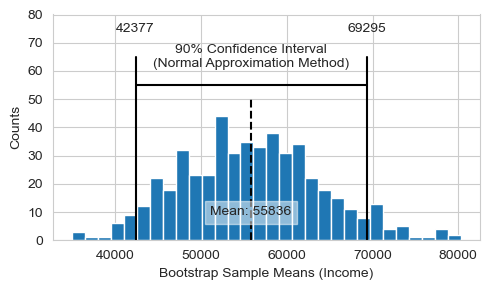

([42376.76041605358, 69294.9387839464], 55835.849599999994, 8182.545220690021)

In [32]:
# Normal Approximation Method:
"""
Bootstrap Confidence Interval for the Mean (Normal Approximation Method)

This code estimates the uncertainty (variability) of the sample mean income of loan applicants
using the bootstrap method with a Normal Approximation.

Assumption:
- The variable `loans_income` is treated as the true population.
- The bootstrap sampling distribution of the sample mean is assumed to be approximately normal.

Steps:
1. Take one random sample of 20 observations from the full dataset (without replacement). This is the original sample.
2. Generate 500 bootstrap resamples from that sample (with replacement).
3. Compute the mean of each resample to form the bootstrap sampling distribution.
4. Estimate the standard error (SE) as the standard deviation of the bootstrap means.
5. Use the Normal Approximation formula to construct a 90% confidence interval:
   CI = bootstrap_mean ± z* × SE, where z* = 1.645 (for 90% confidence)
6. Plot the bootstrap distribution of the means, annotate the CI and bootstrap mean.

Why this approach?
------------------------------------------------
If the bootstrap distribution is approximately normal (bell-shaped and symmetric),
we can use the standard error of the bootstrap means and apply the normal formula
to construct the confidence interval, instead of relying on percentile cutoffs.

This is faster, and in large samples or well-behaved distributions, often quite accurate.
"""
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.utils import resample  # or use np.random.choice manually if needed
import scipy.stats as stats

# Print the population mean
print(f'Population mean income: {loans_income.mean():.2f}')

np.random.seed(3)  

# Step 1: Take one random sample of 20 observations from the population
sample20 = resample(loans_income, n_samples=20, replace=False)
print(f'Sample of 20 mean income: {sample20.mean():.2f}')

# Step 2: Bootstrap resampling
bootstrap_means = []
for _ in range(500):
    boot_sample = resample(sample20)
    bootstrap_means.append(boot_sample.mean())

bootstrap_means = pd.Series(bootstrap_means)

# Step 3: Assess normality of bootstrap distribution using histogram and Q-Q plot values
boot_mean = bootstrap_means.mean()
boot_std = bootstrap_means.std(ddof=1)
print(f'mean of bootstrap distribution: {boot_mean:.2f}')
print(f'std of bootstrap distribution: {boot_std:.2f}')

# Compute z* for 90% confidence interval
z_star = stats.norm.ppf(0.95)  # 1.645 for one-sided, 90% two-sided = ±1.645       ## stats.norm.ppf(0.05) = -1.645    ## stats.norm.ppf(0.95) = +1.645

# Step 4: Construct 90% CI using normal approximation method
ci_normal = [boot_mean - z_star * boot_std, boot_mean + z_star * boot_std]

# Step 5: Plot the histogram and annotate the normal approximation interval
fig, ax = plt.subplots(figsize=(5, 3))
bootstrap_means.plot.hist(bins=30, ax=ax)

# Plot the confidence interval
ax.plot(ci_normal, [55, 55], color='black')
for x in ci_normal:
    ax.plot([x, x], [0, 65], color='black')
    ax.text(x, 75, f'{x:.0f}', ha='center', va='center')

# Label the interval
ax.text(sum(ci_normal) / 2, 65, '90% Confidence Interval\n(Normal Approximation Method)', ha='center', va='center')

# Draw and annotate the mean
ax.plot([boot_mean, boot_mean], [0, 50], color='black', linestyle='--')
ax.text(boot_mean, 10, f'Mean: {boot_mean:.0f}',
        bbox=dict(facecolor='white', edgecolor='white', alpha=0.5),
        ha='center', va='center')

# Final plot formatting
ax.set_ylim(0, 80)
ax.set_ylabel('Counts')
ax.set_xlabel('Bootstrap Sample Means (Income)')
plt.tight_layout()
plt.show()

ci_normal, boot_mean, boot_std


### **✅ Why we use z-distribution (not t-distribution) in the bootstrap normal approximation method:**

Not because we use the "true" standard deviation — we still estimate it.  
But because bootstrap resampling itself already reflects the variability and uncertainty that the t-distribution was designed to handle in classical inference.

**Here's the key difference:**

| Classical Approach                                   | Bootstrap Approach                      |
|-----------------------------------------------------|---------------------------------------|
| Use t-distribution when sample size is small and σ is unknown | Don’t assume anything — resample empirically |
| Standard error is analytically estimated (e.g., s/√n) | SE is empirically estimated via bootstrap |
| t-distribution adjusts for small n                   | Bootstrap handles that via spread of resamples |
| Only one sample is available                          | Simulate many samples via resampling  |

**In our code:**

```python
boot_std = bootstrap_means.std(ddof=1)
``` 

This is still an estimate, not the true standard deviation of the population — but it's an estimate based on empirical variation across 500 bootstrap samples, not a theoretical formula like $s / \sqrt{n}$.

So:

- ✔️ We're not assuming normality.  
- ✔️ We're not assuming known σ.  
- ✔️ We're estimating SE directly from data.  

✅ Therefore, we can use z* safely for normal approximation.


**Conclusion:**  

we use the z-distribution in bootstrap normal approximation not because we have the true σ — but because the bootstrap simulates the sampling distribution directly, making the extra “fattening” of the tails (which t-distribution does) unnecessary.


**Intuition:**  
- In classical stats, the t-distribution adjusts for extra uncertainty in estimating the population std. dev (σ) from small samples.  
- In bootstrap, we're already empirically estimating the variability — so that adjustment is baked into our resampled SE.  

***The asterisk in z* (pronounced “z-star”)**

The asterisk is just a notation convention used in statistics to indicate that:

🔹 $z^*$ is a critical value from the standard normal distribution (z-distribution) corresponding to a desired confidence level.

**For example:**  

- $z^* = 1.96$ → used for a 95% confidence interval  
- $z^* = 1.645$ → for a 90% confidence interval  
- $z^* = 2.576$ → for a 99% confidence interval  

**Why the asterisk?**  

It helps distinguish:

- $z$ = a standard normal random variable  
- $z^*$ = a specific quantile or cutoff point (e.g., the 97.5th percentile)  



### **✅ The relationship between the bootstrap resampling distribution and the t-distribution**

The relationship is subtle but important, especially in statistical inference.

**Quick Summary:**

| Concept                 | Bootstrap Resampling Distribution                                      | t-Distribution                                                  |
|-------------------------|------------------------------------------------------------------------|----------------------------------------------------------------|
| Definition              | Empirical distribution of a statistic via resampling                   | Theoretical distribution of standardized sample means when σ is unknown |
| Origin                  | Built from data (resampling with replacement)                          | Derived mathematically from normal theory                       |
| Use case                | Estimate uncertainty (SE, CI) without strong assumptions               | Adjusts for small-sample uncertainty when σ is unknown          |
| Shape                   | Often approximates a normal distribution if n is large                 | Like normal, but with heavier tails (more variability for small n) |
| When used               | Especially when analytic formulas are hard or unreliable               | Classical inference with small n or unknown σ                   |
| Confidence intervals    | Built using percentiles or normal approximation of the resample        | Built using t* × SE when σ is unknown and n is small            |

**Relationship Explained:**

1. **Both aim to handle sampling uncertainty**  
   The t-distribution accounts for extra variability when estimating the population standard deviation from small samples.  
   The bootstrap does the same empirically: it reflects the variability of the sample statistic directly from resampling.

2. **Bootstrap vs t-distribution in Confidence Intervals**  
   Classical formula:  
   $$
   CI = \bar{x} \pm t^* \cdot \frac{s}{\sqrt{n}}
   $$  
   we rely on the t-distribution because we don’t know the population σ.  

   But if we use bootstrap, we:  
   - Generate a sampling distribution of the statistic (e.g., sample mean),  
   - Estimate its standard error directly from the resamples,  
   - And optionally build a CI using normal approximation:  
   $$
   \bar{x}_{boot} \pm z^* \cdot SE_{boot}
   $$  
   or bootstrap percentiles.  

   So in bootstrap, the role of the t-distribution is essentially replaced by the empirical resampling distribution.

**Fun Fact:**

There is a technique called the **bootstrap-t method**, where we combine ideas from both:  
- we compute a t-like statistic from bootstrap samples,  
- Then use that distribution to build better confidence intervals.

**Conclusion:**  

Bootstrap and t-distributions both solve the same problem — but in different ways:  
- The t-distribution does it analytically based on assumptions.  
- The bootstrap does it empirically using resampling from data.



**weshould **not** use both the bootstrap and the t-distribution at the same time in the same inference step.**  

**Why?**

Because they are alternative methods to solve the same problem:  
Estimating uncertainty (e.g., confidence intervals) when the population distribution or standard deviation is unknown.

**Choose one based on the situation:**  

| Situation                                         | Recommended Approach       |
|-------------------------------------------------|---------------------------|
| we have a small sample and assume normality     | Use t-distribution         |
| we have a small or large sample but don’t want to assume normality | Use bootstrap              |
| we need flexibility (median, IQR, regression params) | Use bootstrap — t-distribution is limited to mean/variance-based stats |
| we are in an exam or textbook scenario           | Use t-distribution (standard assumption) |


**What not to do:**  

Avoid things like:

❌ Not correct — mixing bootstrap with t-distribution
 
```python
CI = bootstrap_mean ± t* × std(bootstrap_sample) 
``` 

Why wrong? Because t* assumes a theoretical distribution, while the bootstrap already reflects the sampling distribution empirically.


**✅ Instead:**

Pick one:

- **t-based CI:**  
  $$
  \bar{x} \pm t^* \cdot \frac{s}{\sqrt{n}}
  $$

- **bootstrap CI (normal approx):**  
  $$
  \bar{x}_{boot} \pm z^* \cdot SE_{boot}
  $$

- **bootstrap CI (percentile):**  
  Use the 2.5th and 97.5th percentiles of resampled statistics.


**Final Thought:**  

The bootstrap doesn’t need t* — because it builds the sampling distribution itself.  
we either trust theory (t-distribution) or trust data (bootstrap), not both at once.



### **✅ Assessing normality of bootstrap distribution using histogram and Q-Q plot values**

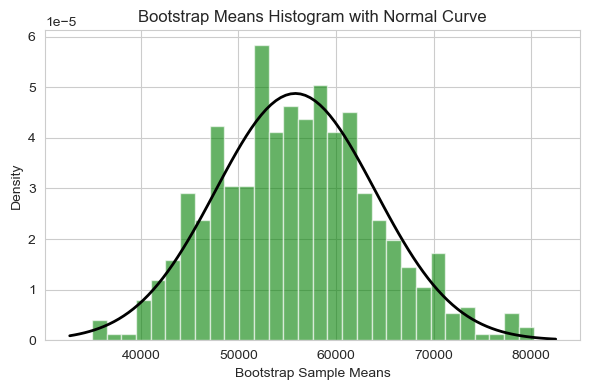

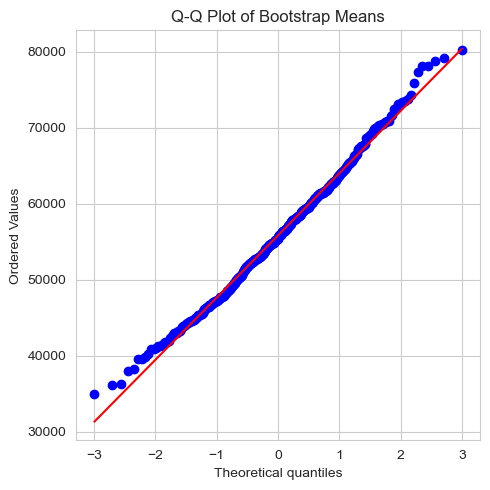

,Skewness,Excess Kurtosis,Shapiro-Wilk p-value,D’Agostino p-value
0,0.240524,-0.115638,0.060181,0.082116


In [33]:
"""
Bootstrap Normality Assessment for Sample Means

The following code snippet evaluates whether the distribution of bootstrap sample means (derived from a sample of 20 incomes)
is approximately normal—a key assumption for applying the Normal Approximation method when building confidence intervals.

Steps:
1. Draw one random sample of 20 values from the `loans_income` dataset (treated as the population).
2. Generate 500 bootstrap resamples (with replacement) from this sample.
3. Compute the mean of each resample to form a bootstrap distribution of sample means.
4. Assess normality using:
   - **Skewness** (should be close to 0)
   - **Excess Kurtosis** (should be close to 0 for normality)
   - **Shapiro-Wilk test** (p > 0.05 indicates normality)
   - **D’Agostino and Pearson test** (p > 0.05 indicates normality)
5. Visualize the distribution:
   - A histogram overlaid with the normal distribution curve
   - A Q-Q plot comparing bootstrap means to a normal distribution

These checks help determine whether it is reasonable to use the Normal Approximation method for constructing confidence intervals.
"""

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm, skew, kurtosis, shapiro, normaltest, probplot
from sklearn.utils import resample

# Set seed for reproducibility
np.random.seed(3)

# Take a sample of 20 observations from the population (without replacement)
sample20 = resample(loans_income, n_samples=20, replace=False)

# Generate 500 bootstrap resamples and compute sample means
bootstrap_means = []
for _ in range(500):
    boot_sample = resample(sample20)
    bootstrap_means.append(boot_sample.mean())
bootstrap_means = pd.Series(bootstrap_means)

# Normality assessment
bootstrap_skewness = skew(bootstrap_means)
bootstrap_kurtosis = kurtosis(bootstrap_means)  # excess kurtosis
shapiro_test = shapiro(bootstrap_means)
dago_test = normaltest(bootstrap_means)
'''
Skewness:
Measures the asymmetry of the distribution.
→ 0 indicates perfect symmetry (normal); >0 = right-skewed, <0 = left-skewed.

Excess Kurtosis:
Measures the "tailedness" of the distribution compared to normal.
→ 0 indicates normal kurtosis; >0 = heavier tails, <0 = lighter tails.

Shapiro-Wilk Test:
A statistical test that checks if data comes from a normal distribution.
→ p > 0.05: fail to reject normality (data likely normal).

D’Agostino and Pearson Test:
Combines skewness and kurtosis into a single test of normality.
→ p > 0.05: fail to reject normality (data likely normal).
'''

# Plot histogram with normal curve overlay
plt.figure(figsize=(6, 4))
count, bins, ignored = plt.hist(bootstrap_means, bins=30, density=True, alpha=0.6, color='g')   
'''
Plots a histogram of the bootstrap means using 30 bins. 
count, bins, and ignored hold the bar heights, bin edges, and unused output respectively.
density=True scales the histogram so the area under the bars sums to 1 (i.e., a probability density).
'''
mu, std = bootstrap_means.mean(), bootstrap_means.std()
xmin, xmax = plt.xlim()
'''
Gets the x-axis limits.
Generates 100 equally spaced values between xmin and xmax to create a smooth curve.
'''
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)    #Calculates the normal distribution's PDF (bell curve) with the same mu and std as our bootstrap means.
plt.plot(x, p, 'k', linewidth=2)
plt.title("Bootstrap Means Histogram with Normal Curve")
plt.xlabel("Bootstrap Sample Means")
plt.ylabel("Density")
plt.grid(True)
plt.tight_layout()
plt.show()

# Q-Q Plot
plt.figure(figsize=(5, 5))
probplot(bootstrap_means, dist="norm", plot=plt) 
'''
By default, dist="norm", which means it compares the quantiles of the observed data (bootstrap_means)
to the quantiles of a standard normal distribution.

HOWEVER, the reference line is NOT based on the standard normal distribution.
The line is fitted to the data using its own estimated mean and standard deviation,
so it generally follows the form y = std * x + mean.

This means the reference line will only be y = x if the data has already been standardized
(i.e., mean = 0 and std = 1).
'''
plt.title("Q-Q Plot of Bootstrap Means")
plt.tight_layout()
plt.show()
'''
A Q-Q plot (Quantile-Quantile plot) is a graphical tool used to assess whether a 
dataset follows a particular theoretical distribution — most commonly, the normal distribution.

🔍 What it shows:
It plots the quantiles of our observed data against the quantiles of the theoretical distribution .

If the data follows the theoretical distribution, the points will lie approximately along a straight diagonal line.

✅ In the context of normality:
    we use it to visually check if our data is normally distributed.
    If the points in the plot closely follow the diagonal line, it suggests the data is approximately normal.
    Deviations from the line, especially at the ends (tails), indicate non-normality, such as skewness or heavy/light tails.

    
The Straight Line: This is the reference line that represents what the quantiles would look like if our data were perfectly normally distributed. Think of it as the "ideal" case.
The Points: These are the quantiles of our actual data (bootstrap_means). Each point compares a quantile from our sample to the corresponding quantile from a normal distribution.

✅ Interpretation:
    If the points fall close to the line (especially in the middle and only deviate slightly in the tails), our data is approximately normal.
    If the points curve away from the line:
        Upward bend in the right tail → right-skewed data
        Downward bend in the left tail → left-skewed data
        S-shape or bowing → issues with kurtosis (too peaked or too flat)
'''

table = pd.DataFrame({
    "Skewness": [bootstrap_skewness],
    "Excess Kurtosis": [bootstrap_kurtosis],
    "Shapiro-Wilk p-value": [shapiro_test.pvalue],
    "D’Agostino p-value": [dago_test.pvalue]
})
table


The table and plots above assess whether the bootstrap sampling distribution of the sample mean is approximately normal. Here’s how to interpret them:
- Skewness ≈ 0: Indicates symmetry. our value of -0.16 shows very slight left skew—negligible.
- Excess Kurtosis ≈ 0: Indicates normal tails. our value of 0.39 is close enough.
- Shapiro-Wilk and D’Agostino p-values > 0.05: Fail to reject normality.

✅ Conclusion: The bootstrap distribution is approximately normal, so using the normal approximation method for confidence intervals is statistically justified in this case

In [34]:
loans_income.shape

(50000,)

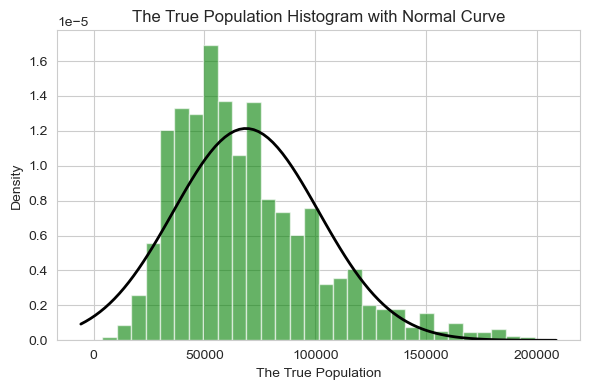

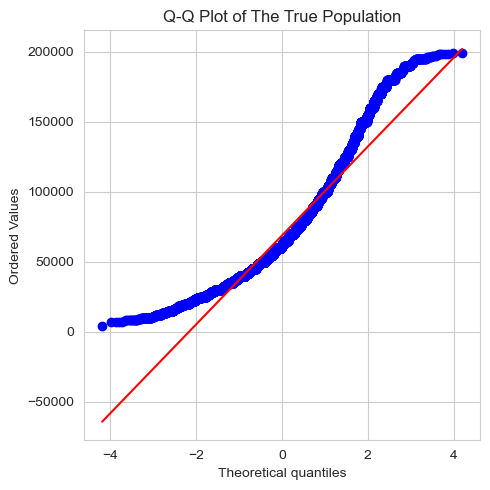

,Skewness,Excess Kurtosis,Shapiro-Wilk p-value,D’Agostino p-value
0,1.048811,1.080752,0.060181,0.0


In [35]:
# Now I'm curious about the distribution of our true population (loans_income): 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm, skew, kurtosis, shapiro, normaltest, probplot
from sklearn.utils import resample

True_population = pd.Series(loans_income)

# Normality assessment
True_population_skewness = skew(True_population)
True_population_kurtosis = kurtosis(True_population)  # excess kurtosis
# shapiro_test = shapiro(True_population)   # Shapiro-Wilk is not intended for large sample sizes. It's most reliable for N < 5000. For large datasets, D’Agostino & Pearson is generally better.
# ⚠️ Shapiro-Wilk may not be accurate for N > 5000. Use D’Agostino test as primary in this case.
dago_test = normaltest(True_population)
'''
Skewness:
Measures the asymmetry of the distribution.
→ 0 indicates perfect symmetry (normal); >0 = right-skewed, <0 = left-skewed.

Excess Kurtosis:
Measures the "tailedness" of the distribution compared to normal.
→ 0 indicates normal kurtosis; >0 = heavier tails, <0 = lighter tails.

Shapiro-Wilk Test:
A statistical test that checks if data comes from a normal distribution.
→ p > 0.05: fail to reject normality (data likely normal).

D’Agostino and Pearson Test:
Combines skewness and kurtosis into a single test of normality.
→ p > 0.05: fail to reject normality (data likely normal).
'''

# Plot histogram with normal curve overlay
plt.figure(figsize=(6, 4))
count, bins, ignored = plt.hist(True_population, bins=30, density=True, alpha=0.6, color='g')   
'''
Plots a histogram of the True_population using 30 bins. 
count, bins, and ignored hold the bar heights, bin edges, and unused output respectively.
density=True scales the histogram so the area under the bars sums to 1 (i.e., a probability density).
'''
mu, std = True_population.mean(), True_population.std()
xmin, xmax = plt.xlim()
'''
Gets the x-axis limits.
Generates 100 equally spaced values between xmin and xmax to create a smooth curve.
'''
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)    #Calculates the normal distribution's PDF (bell curve) with the same mu and std as our bootstrap means.
plt.plot(x, p, 'k', linewidth=2)
plt.title("The True Population Histogram with Normal Curve")
plt.xlabel("The True Population")
plt.ylabel("Density")
plt.grid(True)
plt.tight_layout()
plt.show()

# Q-Q Plot
plt.figure(figsize=(5, 5))
probplot(True_population, dist="norm", plot=plt)
plt.title("Q-Q Plot of The True Population")
plt.tight_layout()
plt.show()
'''
A Q-Q plot (Quantile-Quantile plot) is a graphical tool used to assess whether a 
dataset follows a particular theoretical distribution — most commonly, the normal distribution.

🔍 What it shows:
It plots the quantiles of our observed data against the quantiles of the theoretical distribution.

If the data follows the theoretical distribution, the points will lie approximately along a straight diagonal line.

✅ In the context of normality:
    weuse it to visually check if our data is normally distributed.
    If the points in the plot closely follow the diagonal line, it suggests the data is approximately normal.
    Deviations from the line, especially at the ends (tails), indicate non-normality, such as skewness or heavy/light tails.

    
The Straight Line: This is the reference line that represents what the quantiles would look like if our data were perfectly normally distributed. Think of it as the "ideal" case.
The Points: These are the quantiles of our actual data (bootstrap_means). Each point compares a quantile from our sample to the corresponding quantile from a normal distribution.

✅ Interpretation:
    If the points fall close to the line (especially in the middle and only deviate slightly in the tails), our data is approximately normal.
    If the points curve away from the line:
        Upward bend in the right tail → right-skewed data
        Downward bend in the left tail → left-skewed data
        S-shape or bowing → issues with kurtosis (too peaked or too flat)
'''

table = pd.DataFrame({
    "Skewness": [True_population_skewness],
    "Excess Kurtosis": [True_population_kurtosis],
    "Shapiro-Wilk p-value": [shapiro_test.pvalue],
    "D’Agostino p-value": [dago_test.pvalue]
})
table
# Metric	                    Description
# Skewness	                    Should be near 0 for symmetry
# Excess Kurtosis	            Should be near 0 for normal-like "tail heaviness"
# Shapiro-Wilk p-value	        Use only for N < 5000; p > 0.05 → data likely normal
# D’Agostino p-value	        Combines skew + kurtosis; p > 0.05 → data likely normal

**Interpretation of the results:**  


**1. Histogram with Normal Curve**

**What it shows:**

we plotted the actual distribution of our income data and overlaid a normal curve using the same mean and standard deviation.

**Interpretation:**  

- The histogram is right-skewed: there's a longer tail to the right.  
- The data are not symmetric around the mean.  
- The bell curve (black line) does not fit the data well, especially in the left half and the tails.


**Verdict:**  

Visual evidence of non-normality.

**2. Q-Q Plot**  

**What it shows:**  

A Q-Q plot compares quantiles of our data vs. quantiles from a perfectly normal distribution.

**Interpretation:**  

- The points deviate sharply from the red diagonal line, especially at the ends (tails).  
- The upper tail bends upward → heavy right tail.  
- The lower tail bends downward → lighter left tail or truncation.  
- The S-shape curve is classic for positive skew and kurtosis (fat right tail).


**Verdict:**  

Strong visual evidence against normality.

**3. Statistical Tests & Summary Table**  

| Metric          | Value     | Interpretation                          |
|-----------------|-----------|---------------------------------------|
| Skewness        | 1.05      | ➤ Strong right skew (normal = 0)      |
| Excess Kurtosis | 1.08      | ➤ Heavier tails than normal (normal = 0) |
| Shapiro-Wilk p  | 3.22e-87  | ➤ p ≪ 0.05 → reject normality          |
| D’Agostino p    | 0.0       | ➤ Strong rejection of normality        |



**🔬 Both tests strongly reject the null hypothesis of normality.**  


**Final Conclusion:**  

our true population distribution (`loans_income`) is **not normal**.  
It is right-skewed, has heavy tails, and fails both visual and statistical tests for normality.

**However…**  

**Central Limit Theorem Insight:**  

Even though the raw data (our true population) are not normal, our earlier work showed that the distribution of the sample mean (via bootstrap) approaches normality — which confirms the central limit theorem.

✅ This is why we can use a normal approximation when working with sample means, even if the population isn't normal — as long as our sample size is large enough.


Population mean income: 68760.52
Sample of 20 mean income: 55734.10
Mean of the Bootstrap resampling Distribution: 55835.85
std of bootstrap distribution Distribution: 8182.55


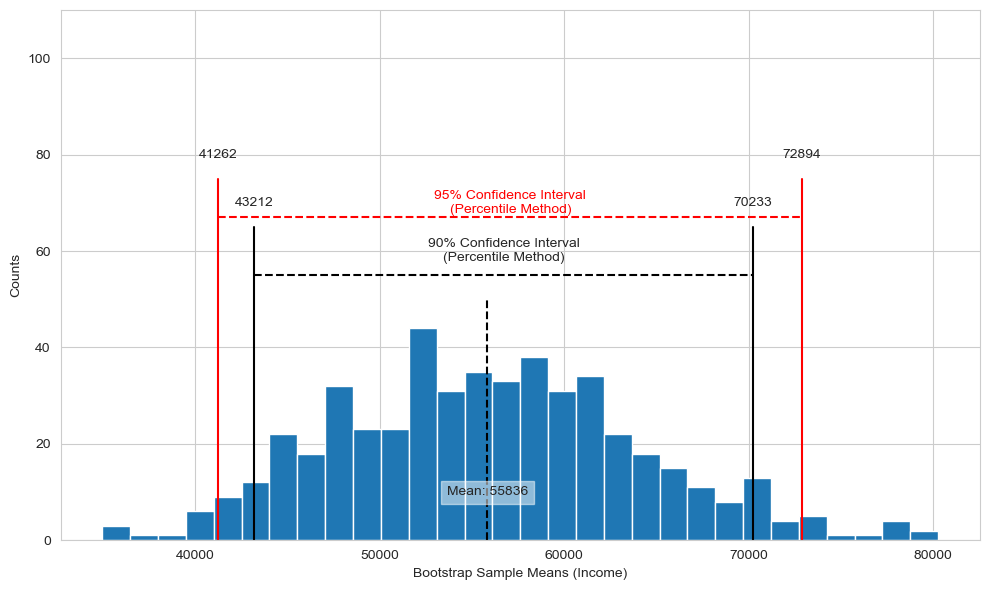

In [36]:
# Percentile Method:
"""
Bootstrap Confidence Interval for the Mean (Sample of 20)

This code simulates the process of estimating the uncertainty (variability) of the mean
annual income of loan applicants using the bootstrap method.

Assumption:
- The variable `loans_income` is treated as the true population.

Steps:
1. Take one random sample of 20 observations from the full dataset (without replacement). It's going to be our original sample.
2. Generate 500 bootstrap resamples from that sample (with replacement).
3. For each resample, compute the sample mean.
4. Construct a 90% confidence interval using the 5th and 95th percentiles of the bootstrap means.
5. Plot a histogram of the bootstrap distribution, mark the confidence interval, and annotate the mean.

This process helps visualize how the sample mean might vary if we could resample repeatedly
and gives an empirical sense of the estimation uncertainty.

Why assume `loans_income` is the population?
------------------------------------------------
In practice, we usually only have access to a limited sample — not the entire population.
To simulate such a real-world scenario, we treat `loans_income` as the full population and
take one small sample (n=20) from it (our original sample). We then apply the bootstrap to that sample to estimate
how much the sample mean might vary. 

If we instead bootstrapped directly on `loans_income`, we’d be estimating the confidence
interval of the dataset's own mean — not simulating the sampling process itself.
"""

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.utils import resample  # or use np.random.choice manually if needed

# Print the population mean
print(f'Population mean income: {loans_income.mean():.2f}')

np.random.seed(3)  

# Step 1: Take one random sample of 20 observations from the population
sample20 = resample(loans_income, n_samples=20, replace=False)
print(f'Sample of 20 mean income: {sample20.mean():.2f}')

# Step 2: Bootstrap resampling
bootstrap_means = []
for _ in range(500):
    boot_sample = resample(sample20)  # sample with replacement
    bootstrap_means.append(boot_sample.mean())

bootstrap_means = pd.Series(bootstrap_means)
print(f'Mean of the Bootstrap resampling Distribution: {bootstrap_means.mean():.2f}')
print(f'std of bootstrap distribution Distribution: {bootstrap_means.std(ddof=1):.2f}')
# Step 3: Compute 90% confidence interval (percentile method)
confidence_interval1 = list(bootstrap_means.quantile([0.05, 0.95]))  #[43212.45, 70233.43999999999]
# Compute 95% confidence interval (percentile method)
confidence_interval2 = list(bootstrap_means.quantile([0.025, 0.975]))  #[41262.222499999996, 72893.77249999999]

# Step 4: Plot the histogram and annotate the results
ax = bootstrap_means.plot.hist(bins=30, figsize=(10, 6)) #This line creates a histogram of the 500 bootstrap means (stored in bootstrap_means), giving wea sense of their distribution.
ax.plot(confidence_interval1, [55, 55], color='black', linestyle='--') #Draws a horizontal line at height 55 between the lower and upper bounds of the confidence interval to visually mark it.
ax.plot(confidence_interval2, [67, 67], color='red', linestyle='--')
# Draw vertical lines and annotate interval bounds
for x in confidence_interval1:
    ax.plot([x, x], [0, 65], color='black')
    ax.text(x, 70, f'{x:.0f}', ha='center', va='center')
'''
For each bound of the interval (lower and upper), it:
    Draws a vertical line from y=0 to y=65.
    Adds a text label above the line to show the exact value (rounded).
'''
for x in confidence_interval2:
    ax.plot([x, x], [0, 75], color='red')
    ax.text(x, 80, f'{x:.0f}', ha='center', va='center')
# Label the interval
ax.text(sum(confidence_interval1) / 2, 60, '90% Confidence Interval\n(Percentile Method)',ha='center', va='center')
ax.text(sum(confidence_interval2) / 2, 70, '95% Confidence Interval\n(Percentile Method)',ha='center', va='center', color ='red')
# Draw and annotate the mean of the bootstrap distribution
boot_mean = bootstrap_means.mean()
ax.plot([boot_mean, boot_mean], [0, 50], color='black', linestyle='--')
ax.text(boot_mean, 10, f'Mean: {boot_mean:.0f}',
        bbox=dict(facecolor='white', edgecolor='white', alpha=0.5),
        ha='center', va='center')
'''
bbox=dict(...)
This creates a background box behind the text:
    facecolor='white': white background to make the text easier to read
    edgecolor='white': white border around the box
    alpha=0.5: semi-transparent (50% opacity) so it doesn't block too much of the plot
ha='center', va='center'
These control horizontal and vertical alignment of the text:
    ha='center': center the text horizontally at boot_mean
    va='center': center the text vertically at y=10
'''
# Final plot tweaks
ax.set_ylim(0, 110)
ax.set_ylabel('Counts')
ax.set_xlabel('Bootstrap Sample Means (Income)')    #we generated 500 bootstrap resamples from that sample (with replacement).
plt.tight_layout()
plt.show()


In [37]:
list(bootstrap_means.quantile([0.025, 0.975]))

[41262.222499999996, 72893.77249999999]

In [38]:
list(bootstrap_means.quantile([0.05, 0.95]))

[43212.45, 70233.43999999999]

### **Standard Normal and QQ-Plots**  
The package `scipy` has the function (`scipy.stats.probplot`) to create QQ-plots. The argument `dist` specifies the distribution, which is set by default to the normal distribution (`dist = "norm"`).

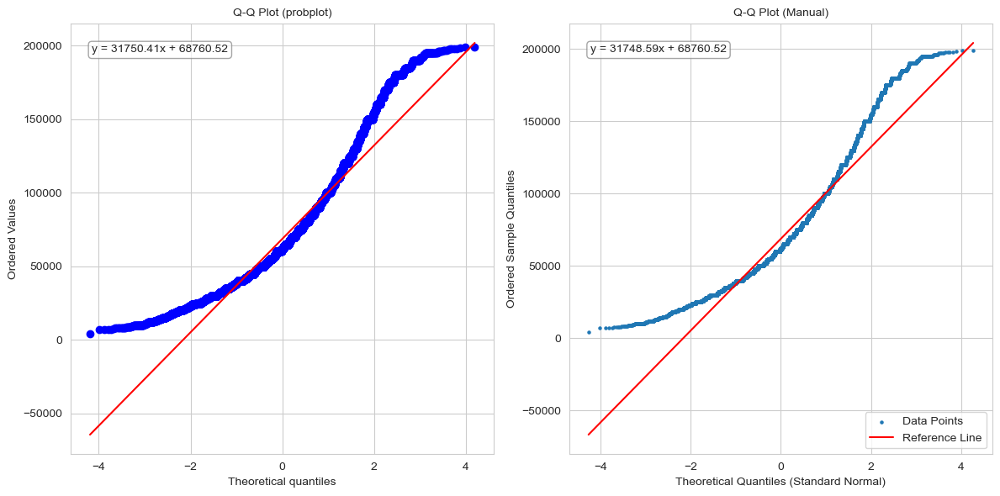

In [39]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import probplot, norm

# Prepare the data
sample = True_population.dropna().values    #a (50000,) NumPy array     #type(True_population)= pandas.core.series.Series       #type(sample)=numpy.ndarray
sample_sorted = np.sort(sample)
n = len(sample_sorted)
theoretical_quantiles = norm.ppf((np.arange(1, n + 1) - 0.5) / n)

# Set up subplots
fig, axes = plt.subplots(1, 2, figsize=(12, 6))  # 1 row, 2 columns

### 1. Q-Q plot using probplot() ###
res, (slope, intercept, r) = probplot(sample, dist="norm", plot=axes[0])
'''
we can also use True_population itself instead of sample since it hasn't got any null value:
probplot(True_population, plot= plt)    or  probplot(True_population, dist="norm", plot=axes[0]) 
By default, dist="norm", which means it compares the quantiles of the observed data (True_population)
to the quantiles of a standard normal distribution.

HOWEVER, the reference line is NOT based on the standard normal distribution.
The line is fitted to the data using OLS (Ordinary Least Squares), solving for: minimize ∑(𝑦𝑖−(𝑠𝑙𝑜𝑝𝑒⋅𝑥𝑖 + 𝑖𝑛𝑡𝑒𝑟𝑐𝑒𝑝𝑡))^2

# Get the line fit parameters from probplot. To display the equation of the reference line in our probplot, we can extract the slope and intercept returned by scipy.stats.probplot(...), and then annotate the plot.
(res, (slope, intercept, r)) = probplot(True_population, dist="norm", plot=axes[0])

res = (theoretical_quantiles, ordered_sample_values) So, res does not contain the slope and intercept.
res[0]: Theoretical quantiles (from the standard normal)
res[1]: Ordered sample quantiles (your data)
fit_params: Another tuple of (slope, intercept, r) — used to draw the reference line ---> y = slope *x + intercept
True_population.std() = 32872.03536985002
True_population.mean() = 68760.51844
'''
axes[0].set_title("Q-Q Plot (probplot)", fontsize=10)

# Add equation to first plot
eq1 = f"y = {slope:.2f}x + {intercept:.2f}"
axes[0].text(0.05, 0.95, eq1,
             transform=axes[0].transAxes,
             fontsize=10, va='top', ha='left',
             bbox=dict(boxstyle="round", facecolor="white", edgecolor="gray", alpha=0.7))

### 2. Manual Q-Q plot ###
axes[1].scatter(theoretical_quantiles, sample_sorted, s=5, label="Data Points")

# Manual slope and intercept
cov_xy = np.cov(theoretical_quantiles, sample_sorted, bias=False)[0, 1] #bias = False divide by n-1    #cov_xy is a 2*2 matrix and we want on of its off-diagonal element like [0,1] which is 31747.746951124398.
var_x = np.var(theoretical_quantiles)
manual_slope = cov_xy / var_x
manual_intercept = sample.mean()

# Plot the fitted line
x_vals = np.linspace(min(theoretical_quantiles), max(theoretical_quantiles), 100)
y_vals = manual_slope * x_vals + manual_intercept
axes[1].plot(x_vals, y_vals, color='red', label='Reference Line')

# Add equation
eq2 = f"y = {manual_slope:.2f}x + {manual_intercept:.2f}"
axes[1].text(0.05, 0.95, eq2,
             transform=axes[1].transAxes,
             fontsize=10, va='top', ha='left',
             bbox=dict(boxstyle="round", facecolor="white", edgecolor="gray", alpha=0.7))

axes[1].set_title("Q-Q Plot (Manual)", fontsize=10)
axes[1].set_xlabel("Theoretical Quantiles (Standard Normal)")
axes[1].set_ylabel("Ordered Sample Quantiles")
axes[1].grid(True)
axes[1].legend()

plt.tight_layout()
plt.show()


### **How does probplot() method calculate the reference line?**  
internally, `scipy.stats.probplot()` uses ordinary least squares (OLS) regression to fit the line, and more specifically, it uses `scipy.stats.linregress()` under the hood to calculate the reference line parameters.

```python
from scipy.stats import linregress
slope, intercept, r, p, stderr = linregress(theoretical_quantiles, sample_sorted)
# output: slope = 31747.95515656777 

res, (slope, intercept, r) = probplot(sample, dist="norm", plot=axes[0])
# output: slope = 31750.406851607877
```
**Why are the slopes slightly different?**

The difference arises because `probplot()` and our manual calculation do **not** use exactly the same x-values (theoretical quantiles):

| In our manual Q-Q plot                          | In `probplot()` internally                                         |
|-------------------------------------------------|-------------------------------------------------------------------|
| We use theoretical quantiles from standard normal distribution via `norm.ppf((i - 0.5) / n)` | It computes its own theoretical quantiles for the same sample size, but using slightly different formulas depending on the SciPy version and method. For example, `norm.ppf((i - a) / (n + 1 - 2a))` where *a* is a small constant like 0.375 or 0.5. |

**Explanation Summary:** 

- Both methods use Ordinary Least Squares (OLS) regression to fit the line.  
- However, they differ slightly in how the theoretical quantiles (x-axis values) are constructed.  
- `probplot()` uses a built-in quantile estimation method which may differ from the standard $\frac{i - 0.5}{n}$ formula we used manually.  
- This causes slight differences in slope and intercept values, but the differences are minor and do not affect interpretation.

**We can make them match!**  

```python
res, (slope, intercept, r) = probplot(sample, dist="norm", fit=True)
theoretical_q = res[0]
sample_sorted = res[1]

# Use the same x and y as probplot used internally
slope2, intercept2, r2, p2, stderr2 = linregress(theoretical_q, sample_sorted)
print(slope2)  # This will n
```

In [40]:
norm.ppf(0.5)

0.0

In [41]:
a = pd.Series(sample_sorted)
a.mean()

68760.51844

In [42]:
True_population.shape

(50000,)

In [43]:
True_population.mean()

68760.51844

0.9658886041951733 
 0.9658333371152796 
 -2.519642926874129e-16


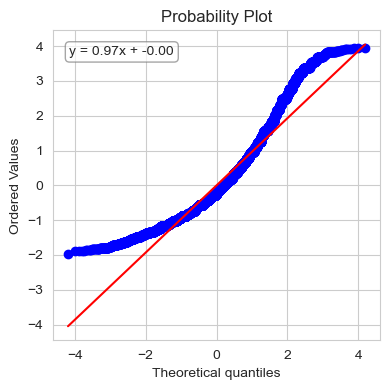

In [44]:
#Q-Q plot for normalized (standardized) data:

fig, ax = plt.subplots(figsize=(4, 4))  

# Prepare the data
sample = True_population.dropna().values    #a (50000,) NumPy array     #type(True_population)= pandas.core.series.Series       #type(sample)=numpy.ndarray
sample_standardized = (sample - sample.mean()) / sample.std()
sample_standardized_sorted = np.sort(sample_standardized)
n = len(sample_standardized)
theoretical_quantiles = norm.ppf((np.arange(1, n + 1) - 0.5) / n)

(res, (slope, intercept, r)) = probplot(sample_standardized, dist="norm", plot=plt)

# Annotate the plot with the line equation
equation = f"y = {slope:.2f}x + {intercept:.2f}"
plt.text(0.05, 0.95, equation,
         transform=plt.gca().transAxes,
         fontsize=10, va='top', ha='left',
         bbox=dict(boxstyle="round", facecolor="white", edgecolor="gray", alpha=0.7))

# Manually compute covariance and variance
cov_xy = np.cov(theoretical_quantiles, sample_standardized_sorted, bias=False)[0, 1]
var_x = np.var(theoretical_quantiles)

manual_slope = cov_xy / var_x
print(slope, '\n', manual_slope, '\n', intercept)
plt.tight_layout()
plt.show()

In [45]:
# You can replicate the Q-Q plot using Plotly with Cufflinks, but since plotly doesn't have a built-in probplot function like scipy.stats.probplot, you'll first need to compute the theoretical quantiles and the ordered sample manually.
# Here’s how to do it using Plotly + Cufflinks:
import pandas as pd
import numpy as np
import scipy.stats as stats
import cufflinks as cf
import plotly.io as pio

# Enable offline mode for Cufflinks
cf.go_offline()

# Step 1: Prepare the sample data
sample = True_population.dropna().values  # make sure it's a 1D array
sample.sort()  # order the data

# Step 2: Calculate theoretical quantiles (from standard normal distribution)
n = len(sample)
quantiles = stats.norm.ppf((np.arange(1, n + 1) - 0.5) / n)

# Step 3: Create a DataFrame to plot
qq_df = pd.DataFrame({
    'Theoretical Quantiles (Normal)': quantiles,
    'Sample Quantiles': sample
})

# Step 4: Q-Q Plot using Cufflinks
qq_df.iplot(kind='scatter', mode='markers', x='Theoretical Quantiles (Normal)', y='Sample Quantiles',
            title='Q-Q Plot of True Population',
            xTitle='Theoretical Quantiles (Standard Normal)',
            yTitle='Ordered Sample Quantiles',
            size=4)


In [46]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import cufflinks as cf

cf.go_offline()

# Step 1: Standardize the sample
sample = True_population.dropna().values
sample = (sample - sample.mean()) / sample.std()  # now z-scores
sample.sort()

# Step 2: Calculate theoretical quantiles (from standard normal)
n = len(sample)
quantiles = stats.norm.ppf((np.arange(1, n + 1) - 0.5) / n)

# Step 3: Create a DataFrame
qq_df = pd.DataFrame({
    'Theoretical Quantiles (Standard Normal)': quantiles,
    'Standardized Sample Quantiles': sample
})

# Step 4: Q-Q Plot
qq_df.iplot(kind='scatter', mode='markers',
            x='Theoretical Quantiles (Standard Normal)',
            y='Standardized Sample Quantiles',
            title='Q-Q Plot (Standardized Sample vs Standard Normal)',
            xTitle='Theoretical Quantiles',
            yTitle='Sample Quantiles (Z-scores)',
            size=4)


In [47]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import cufflinks as cf
import plotly.graph_objs as go

# Enable offline mode
cf.go_offline()

# # Step 1: Prepare sorted sample
# sample = np.sort(True_population.dropna().values)
# Step 1: Standardize the sample
sample = True_population.dropna().values
sample = (sample - sample.mean()) / sample.std()  # now z-scores
sample.sort()

n = len(sample)

# Step 2: Compute theoretical quantiles from standard normal
theoretical_q = stats.norm.ppf((np.arange(1, n + 1) - 0.5) / n)     #theoretical_q.shape: (50000,)

# Step 3: Fit a straight line (for ideal normal data)
slope, intercept = np.polyfit(theoretical_q, sample, 1)
line = slope * theoretical_q + intercept

# Step 4: Create plot
trace_data = go.Scatter(x=theoretical_q, y=sample, mode='markers', name='Sample Quantiles')
trace_line = go.Scatter(x=theoretical_q, y=line, mode='lines', name='Reference Line', line=dict(color='black'))

layout = go.Layout(
    title='Q-Q Plot of True Population vs Standard Normal',
    xaxis=dict(title='Theoretical Quantiles (Standard Normal)'),
    yaxis=dict(title='Ordered Sample Quantiles'),
    width=600,
    height=600
)

fig = go.Figure(data=[trace_data, trace_line], layout=layout)
fig.show()


In [48]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import cufflinks as cf
import plotly.graph_objs as go

# Enable offline mode
cf.go_offline()

# Step 1: Prepare sorted sample
sample = np.sort(True_population.dropna().values)
n = len(sample)

# Step 2: Compute theoretical quantiles from standard normal
theoretical_q = stats.norm.ppf((np.arange(1, n + 1) - 0.5) / n)

# Step 3: Fit a reference line to the data
slope, intercept = np.polyfit(theoretical_q, sample, 1)
line = slope * theoretical_q + intercept

# Step 4: Create plot traces
trace_data = go.Scatter(
    x=theoretical_q,
    y=sample,
    mode='markers',
    name='Sample Quantiles',
    hovertemplate='Theoretical: %{x:.2f}<br>Sample: %{y:.2f}'
)

trace_line = go.Scatter(
    x=theoretical_q,
    y=line,
    mode='lines',
    name='Reference Line',
    line=dict(color='black'),
    hoverinfo='skip'  # Optional: disables hover for the line
)

# Step 5: Define layout with unified hovermode
layout = go.Layout(
    title='Q-Q Plot of True Population vs Standard Normal',
    xaxis=dict(title='Theoretical Quantiles (Standard Normal)'),
    yaxis=dict(title='Ordered Sample Quantiles'),
    width=600,
    height=600,
    hovermode='x unified'  # Unified hover mode enabled here
)

# Step 6: Create and show figure
fig = go.Figure(data=[trace_data, trace_line], layout=layout)
fig.show()


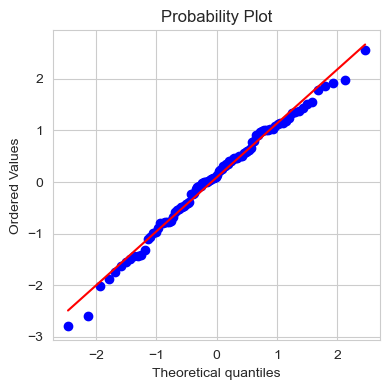

In [49]:
fig, ax = plt.subplots(figsize=(4, 4))

norm_sample = stats.norm.rvs(size=100)
stats.probplot(norm_sample, plot=ax)

plt.tight_layout()
plt.show()

## **Long-Tailed Distributions**

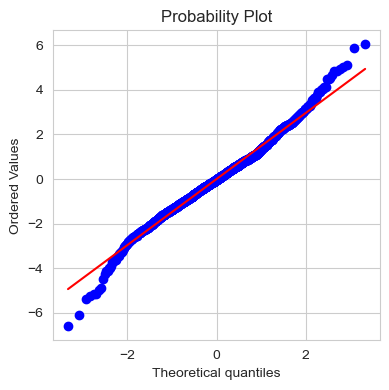

In [63]:
sp500_px = pd.read_csv(SP500_DATA_CSV)

nflx = sp500_px['NFLX']
nflx = np.diff(np.log(nflx[nflx>0]))

fig, ax = plt.subplots(figsize=(4, 4))
stats.probplot(nflx, plot=ax)

plt.tight_layout()
plt.show()

In [ ]:
nflx
# nflx.mean() #0.0015
# nflx.std()  #1.488

57

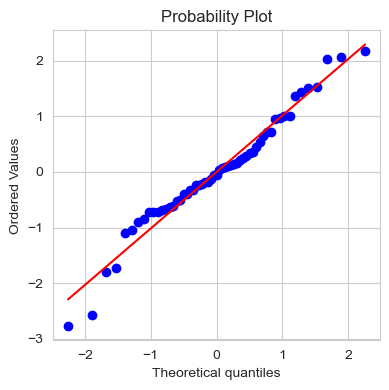

In [68]:
nflx = np.diff(np.log(nflx[nflx>0]))
nflx_normalized = (nflx - nflx.mean())/nflx.std()

fig, ax = plt.subplots(figsize=(4, 4))
stats.probplot(nflx_normalized, dist="norm", plot=plt)



plt.tight_layout()
plt.show()

1.0163413529024388 
 1.013791869046887 
 1.4253038789949085e-16


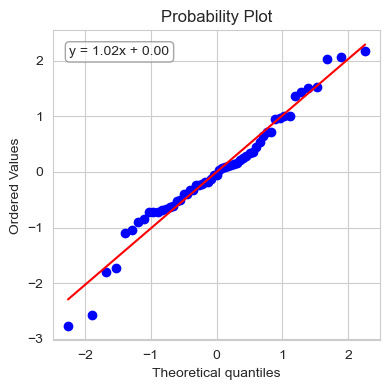

In [70]:
#Q-Q plot for normalized (standardized) data:

fig, ax = plt.subplots(figsize=(4, 4))  

# Prepare the data
sample_normalized = (nflx - nflx.mean())/nflx.std()
n = len(sample_normalized)
sample_standardized_sorted = np.sort(sample_normalized)
theoretical_quantiles = norm.ppf((np.arange(1, n + 1) - 0.5) / n)

(res, (slope, intercept, r)) = probplot(sample_normalized, dist="norm", plot=plt)

# Annotate the plot with the line equation
equation = f"y = {slope:.2f}x + {intercept:.2f}"
plt.text(0.05, 0.95, equation,
         transform=plt.gca().transAxes,
         fontsize=10, va='top', ha='left',
         bbox=dict(boxstyle="round", facecolor="white", edgecolor="gray", alpha=0.7))

# Manually compute covariance and variance
cov_xy = np.cov(theoretical_quantiles, sample_standardized_sorted, bias=False)[0, 1]
var_x = np.var(theoretical_quantiles)

manual_slope = cov_xy / var_x
print(slope, '\n', manual_slope, '\n', intercept)
plt.tight_layout()
plt.show()

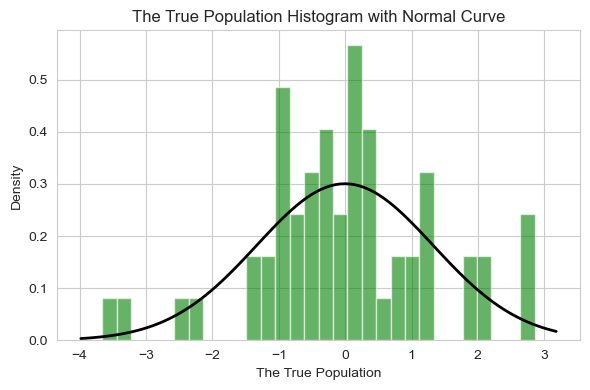

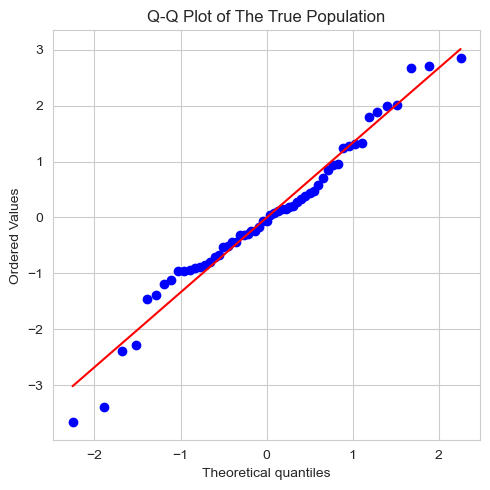

,Skewness,Excess Kurtosis,Shapiro-Wilk p-value,D’Agostino p-value
0,-0.191333,0.665616,0.060181,0.33294


In [79]:
# Now I'm curious about the distribution of our true population (loans_income): 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm, skew, kurtosis, shapiro, normaltest, probplot
from sklearn.utils import resample

True_population = pd.Series(nflx)

# Normality assessment
True_population_skewness = skew(True_population)
True_population_kurtosis = kurtosis(True_population)  # excess kurtosis
# shapiro_test = shapiro(True_population)   # Shapiro-Wilk is not intended for large sample sizes. It's most reliable for N < 5000. For large datasets, D’Agostino & Pearson is generally better.
# ⚠️ Shapiro-Wilk may not be accurate for N > 5000. Use D’Agostino test as primary in this case.
dago_test = normaltest(True_population)
'''
Skewness:
Measures the asymmetry of the distribution.
→ 0 indicates perfect symmetry (normal); >0 = right-skewed, <0 = left-skewed.

Excess Kurtosis:
Measures the "tailedness" of the distribution compared to normal.
→ 0 indicates normal kurtosis; >0 = heavier tails, <0 = lighter tails.

Shapiro-Wilk Test:
A statistical test that checks if data comes from a normal distribution.
→ p > 0.05: fail to reject normality (data likely normal).

D’Agostino and Pearson Test:
Combines skewness and kurtosis into a single test of normality.
→ p > 0.05: fail to reject normality (data likely normal).
'''

# Plot histogram with normal curve overlay
plt.figure(figsize=(6, 4))
count, bins, ignored = plt.hist(True_population, bins=30, density=True, alpha=0.6, color='g')   
'''
Plots a histogram of the True_population using 30 bins. 
count, bins, and ignored hold the bar heights, bin edges, and unused output respectively.
density=True scales the histogram so the area under the bars sums to 1 (i.e., a probability density).
'''
mu, std = True_population.mean(), True_population.std()
xmin, xmax = plt.xlim()
'''
Gets the x-axis limits.
Generates 100 equally spaced values between xmin and xmax to create a smooth curve.
'''
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)    #Calculates the normal distribution's PDF (bell curve) with the same mu and std as our bootstrap means.
plt.plot(x, p, 'k', linewidth=2)
plt.title("The True Population Histogram with Normal Curve")
plt.xlabel("The True Population")
plt.ylabel("Density")
plt.grid(True)
plt.tight_layout()
plt.show()

# Q-Q Plot
plt.figure(figsize=(5, 5))
probplot(True_population, dist="norm", plot=plt)
plt.title("Q-Q Plot of The True Population")
plt.tight_layout()
plt.show()
'''
A Q-Q plot (Quantile-Quantile plot) is a graphical tool used to assess whether a 
dataset follows a particular theoretical distribution — most commonly, the normal distribution.

🔍 What it shows:
It plots the quantiles of our observed data against the quantiles of the theoretical distribution.

If the data follows the theoretical distribution, the points will lie approximately along a straight diagonal line.

✅ In the context of normality:
    weuse it to visually check if our data is normally distributed.
    If the points in the plot closely follow the diagonal line, it suggests the data is approximately normal.
    Deviations from the line, especially at the ends (tails), indicate non-normality, such as skewness or heavy/light tails.

    
The Straight Line: This is the reference line that represents what the quantiles would look like if our data were perfectly normally distributed. Think of it as the "ideal" case.
The Points: These are the quantiles of our actual data (bootstrap_means). Each point compares a quantile from our sample to the corresponding quantile from a normal distribution.

✅ Interpretation:
    If the points fall close to the line (especially in the middle and only deviate slightly in the tails), our data is approximately normal.
    If the points curve away from the line:
        Upward bend in the right tail → right-skewed data
        Downward bend in the left tail → left-skewed data
        S-shape or bowing → issues with kurtosis (too peaked or too flat)
'''

table = pd.DataFrame({
    "Skewness": [True_population_skewness],
    "Excess Kurtosis": [True_population_kurtosis],
    "Shapiro-Wilk p-value": [shapiro_test.pvalue],
    "D’Agostino p-value": [dago_test.pvalue]
})
table
# Metric	                    Description
# Skewness	                    Should be near 0 for symmetry
# Excess Kurtosis	            Should be near 0 for normal-like "tail heaviness"
# Shapiro-Wilk p-value	        Use only for N < 5000; p > 0.05 → data likely normal
# D’Agostino p-value	        Combines skew + kurtosis; p > 0.05 → data likely normal

In [ ]:
# sp500_px.shape  #(5647, 518)
# sp500_px['NFLX'].shape  #(5647,)

(5647,)

In [54]:
sp500_px.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5647 entries, 0 to 5646
Columns: 518 entries, Unnamed: 0 to HSIC
dtypes: float64(517), object(1)
memory usage: 22.3+ MB


To check whether your sp500_px DataFrame contains any NaN (missing) values, you can use the following methods in Pandas:

In [55]:
sp500_px[sp500_px['NFLX'].isna()]

,Unnamed: 0,ADS,CA,MSFT,RHT,CTSH,CSC,EMC,IBM,XRX,...,WAT,ALXN,AMGN,BXLT,BIIB,CELG,GILD,REGN,VRTX,HSIC


In [ ]:
sp500_px.isna().any().any()
# ✅ Returns True if there are any NaNs anywhere in the DataFrame.
# ❌ Returns False if there are no NaNs.
'''
sp500_px.isna()
→ Returns a DataFrame of the same shape as sp500_px, but with True wherever there is a NaN (missing) value and False elsewhere.

.any() (first)
→ When applied to a DataFrame, this returns a Series where each element tells whether any True values exist in each column (i.e., whether each column contains at least one NaN).

.any() (second)
→ This is applied to the resulting Series, and returns a single Boolean: True if any column contains at least one NaN, otherwise False.
'''


False

In [57]:
sp500_px.isna().any()['NFLX']

False

In [85]:
(0.98)**200

0.0175879466057215

### **Binomial Distribution**

In [ ]:
stats.binom.pmf(2, n=5, p=0.1)  #The probability of observing exactly two successes in 5 trials, where the probability of success for each trial is 0.1.

0.07289999999999992

In [ ]:
stats.binom.cdf(2, n=5, p=0.1)  #The probability of observing two or fewer successes in 5 trials, where the probability of success for each trial is 0.1.

0.99144

In [89]:
stats.binom.pmf(0, n=200, p=0.02)

0.017587946605721567

### **Poisson and Related Distribution**  

Poisson Distributions

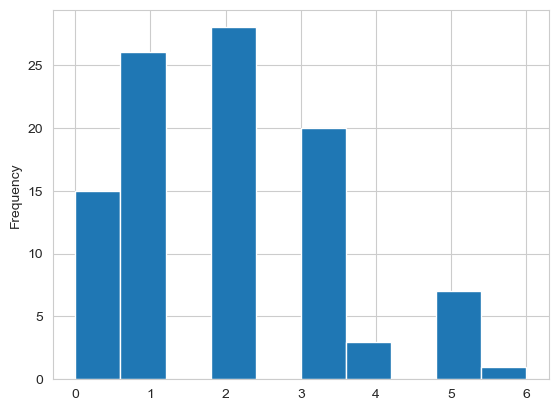

In [ ]:
sample = stats.poisson.rvs(2, size=100)

pd.Series(sample).plot.hist()
plt.show()

# Let's say a call center receives calls at an average rate of 2 calls per minute.
# Using the Poisson distribution, we simulate the number of calls received each minute over a 100-minute period.
# Each value in the sample represents how many calls came in during that minute.
# This pattern is random but follows our expected average (2 calls per minute).

In [112]:
sample[:5]

array([3, 1, 2, 5, 3], dtype=int64)

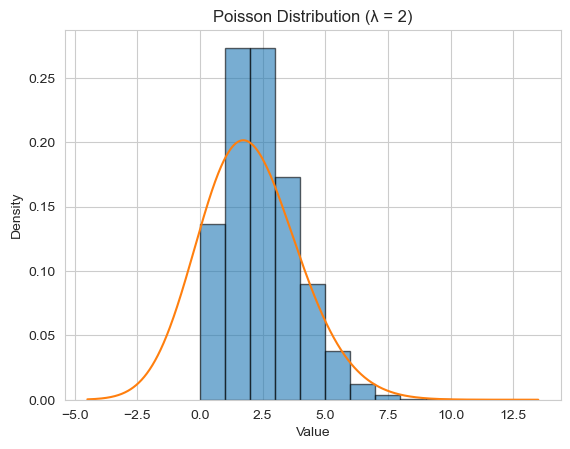

In [108]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats

# Generate Poisson-distributed sample
sample = stats.poisson.rvs(mu=2, size=10000)

# Plot histogram with KDE
pd.Series(sample).plot.hist(bins=range(0, max(sample)+2), density=True, alpha=0.6, edgecolor='black')
# bins=range(0, max(sample)+2) makes bins align with integer values.
# density=True normalizes the histogram so it matches the KDE scale.
pd.Series(sample).plot.kde(bw_method=1)  # Optional: adjust smoothing. 
plt.title("Poisson Distribution (λ = 2)")
'''
The bw_method parameter in .plot.kde() controls the bandwidth of the Kernel Density Estimate (KDE) — which determines how smooth the KDE curve appears.

📌 What is bandwidth?
Bandwidth is a smoothing parameter that affects how closely the KDE follows your data:

more accurate: Bandwidt estimates the standard deviation (spread) for each Gaussian centered at each data point.

A small bandwidth makes the KDE curve wiggly (overfitting).

A large bandwidth makes the KDE curve too smooth (underfitting).

Think of it like this:

It's similar to choosing the bin width in a histogram — narrow bins show more detail, wide bins show more general trends.

✅ Common values:
bw_method='scott' or 'silverman' are standard rules of thumb.

You can also provide a float (like 0.3, 0.5, 1.0, etc.) to manually adjust smoothness.
'''
plt.xlabel("Value")
plt.ylabel("Density")
plt.show()

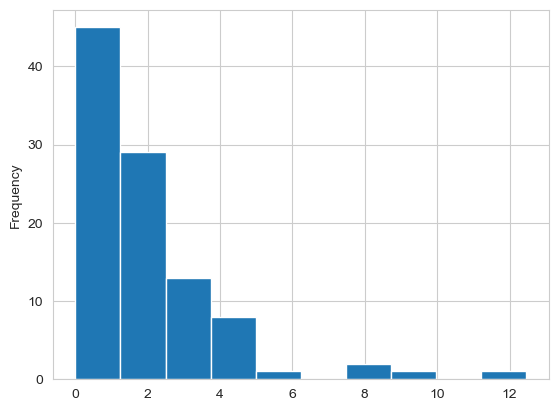

In [ ]:
sample = stats.expon.rvs(scale=2, size=100)

pd.Series(sample).plot.hist()
plt.show()

# Let's say calls come into a call center at an average rate of 2 calls per minute.
# Using the exponential distribution, we simulate a fake version of the call center over 100 minutes.
# Each value in the sample represents the random waiting time until the next call.
# This pattern is random but follows our expected average rate (2 calls per minute).

In [114]:
sample[:5]

array([0.25934481, 1.38774937, 0.76782336, 3.03469086, 1.58707213])

### **Weibull Distribution**

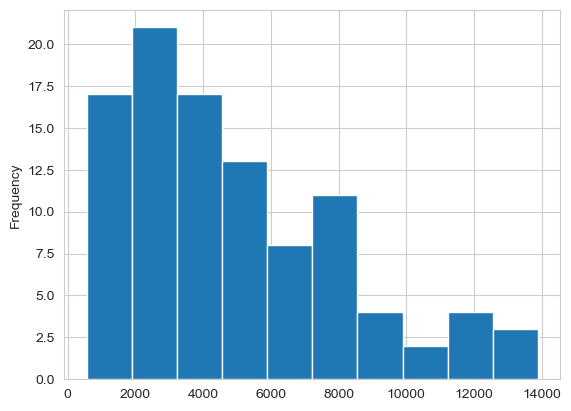

In [115]:
sample = stats.weibull_min.rvs(1.5, scale=5000, size=100)

pd.Series(sample).plot.hist()
plt.show()